# HW3, Schelling's model

1. Suppose there are two types of agents: X and O. Two populations of the two agent types are initially placed into random locations of a neighborhood represented by a grid. After placing all the agents in the grid, each cell is either occupied by an agent or is empty.
2. Now we must determine if each agent is satisfied with its current location. A satisfied agent is one that is surrounded by at least R percent of agents of the same type. This threshold R is one that will apply to all agents in the model.
3. When an agent is not satisfied, it can be moved to any vacant location in the grid. Any algorithm can be used to choose this new location. For example, a randomly selected cell may be chosen, or the agent could move to the nearest available location.
4. All dissatisfied agents must be moved in the same round. After the round is complete, a new round begins, and dissatisfied agents are once again moved to new locations in the grid.

Steps:
1. randomize the map with half white/half black;
2. define the value of R (0, ⅛, ¼, ⅜, ½, ⅝, ¾, ⅞, 1), start the game;
3. on each step for each cell find out if the cell wants to move - this cell is now on the market (considered free for moving in);
4. after you finished with the whole map - cells that want to move can move into free cells;
5. repeat the whole procedure.

CRITERIA:
1. Create 9 gifs of map evolution for 9 values of R (5 points)
2. Plot the number of households that want to move versus time for 9 values of R on one graph, label 9 curves, label the axes and title the graph. (2 points)


In [1]:
from __future__ import annotations

import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
import os
import shutil
import imageio
from IPython.display import Image, display
from random import randint

CMAP = 'tab20c'

In [2]:
class SchellingModel():
    def __init__(self, map_size: int, r: float, empty_coef: int = float):
        self.map_size = map_size
        self.r = r
        self.map = np.random.choice([1,2], size=(self.map_size, self.map_size))
        self.empty_coef = empty_coef

        if self.empty_coef != 0:
            buf = np.random.rand(self.map_size, self.map_size)
            self.map[buf < self.empty_coef] = 0

        self.number_of_unsat = []
        
    def visualize_map(self, figsize: tuple[int]=(6,6),
                      dpi: int|None=150,
                      cmap: str|None = None):
        """
        Просто визуализирует карту симуляции
        """
        plt.figure(figsize = figsize, dpi = dpi)
        plt.imshow(self.map, cmap = CMAP)
        plt.title(f'R = {self.r}')
        plt.show()

    def _is_guy_satisfy(self, x: int, y: int):
        guy = self.map[x, y]

        # проверяем, лежит ли x на границе
        if x in [0, self.map_size - 1]:
            if x == 0:
                _bnds_x = [0, 1]
            else:
                _bnds_x = [-1, 0]
        else:
            _bnds_x = [-1, 0, 1]

        # проверяем, лежит ли y на границе
        if y in [0, self.map_size - 1]:
            if y == 0:
                _bnds_y = [0, 1]
            else:
                _bnds_y = [-1, 0]
        else:
            _bnds_y = [-1, 0, 1]

        # проверяем всех соседей вокруг
        same_guys, total_guys = 0, 0

        for i in _bnds_x:
            for j in _bnds_y:
                # выкидываем из подсчета агента, для которого считаем
                if i == 0 and j == 0:
                    pass
                else:
                    # если это не пустое место, то считает, что это агент
                    if self.map[x + i, y + j] != 0:
                        total_guys += 1
                        if self.map[x + i, y + j] == guy:
                            same_guys += 1

        agent_relation = same_guys / (total_guys+1e-16)
        return agent_relation >= self.r

    def check_satisfaction(self):
        self.unsatisfied_hashmap = {}
        self.free_hashmap = {}

        k1, k2 = 0, 0
        for x in range(self.map_size):
            for y in range(self.map_size):
                if self.map[x, y] == 0:
                    self.free_hashmap[k1] = (x,y)
                    k1 += 1
                elif not self._is_guy_satisfy(x, y):
                    self.free_hashmap[k1] = (x, y)
                    k1 += 1
                    self.unsatisfied_hashmap[k2] = (x,y)
                    k2 += 1

    def iteration(self):
        self.check_satisfaction()
        self.number_of_unsat.append(len(list(self.unsatisfied_hashmap.keys())))
        while True:
            unsat_keys = list(self.unsatisfied_hashmap.keys())
            free_keys = list(self.free_hashmap.keys())

            if len(unsat_keys) <= 1:
                break

            idx_unsat, idx_free = randint(0, len(unsat_keys)-1), randint(0, len(free_keys)-1)

            x1, y1 = self.unsatisfied_hashmap.get(unsat_keys[idx_unsat])
            x2, y2 = self.free_hashmap.get(free_keys[idx_free])

            if x1 == x2 and y1 == y2:
                _ = self.unsatisfied_hashmap.pop(unsat_keys[idx_unsat])
                _ = self.free_hashmap.pop(free_keys[idx_free])
                continue
            else:
                _buf = self.map[x1, y1]
                self.map[x1, y1] = self.map[x2, y2]
                self.map[x2, y2] = _buf
                _ = self.unsatisfied_hashmap.pop(unsat_keys[idx_unsat])
                _ = self.free_hashmap.pop(free_keys[idx_free])


    def make_iteration_process(self, max_iter: int, gif_name: str = 'gifka.gif'):
        self.gif_name = gif_name

        if os.path.isdir('imgs'):
            shutil.rmtree('imgs')
        os.mkdir('imgs')

        images = []
        for i in range(max_iter):
            plt.imshow(self.map, cmap = CMAP)
            plt.title(f'R = {self.r}, iter = {i}')
            image_file_name = f'imgs/sch_model_{i}.png'
            plt.savefig(image_file_name)
            images.append(imageio.v2.imread(image_file_name))
            plt.close()
            self.iteration()
            
        imageio.mimsave(gif_name, images)

    def _display_gif(self):
        with open(self.gif_name, "rb") as f:
            display(Image(data=f.read(), format="gif"))

    def _display_unsat_num(self):
        plt.figure(figsize=(6,4))
        plt.plot(self.number_of_unsat)
        plt.xlabel('iteration')
        plt.ylabel('number of unsatisfyed agents')
        plt.title(f'R = {self.r}')
        plt.show()

  0%|          | 0/9 [00:00<?, ?it/s]

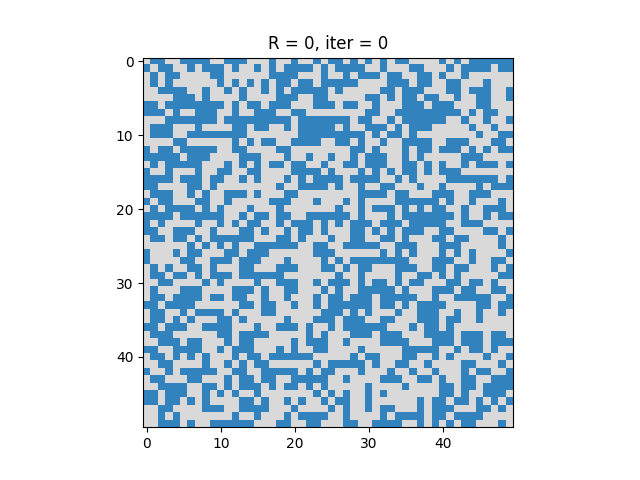

 11%|█         | 1/9 [00:07<01:01,  7.65s/it]

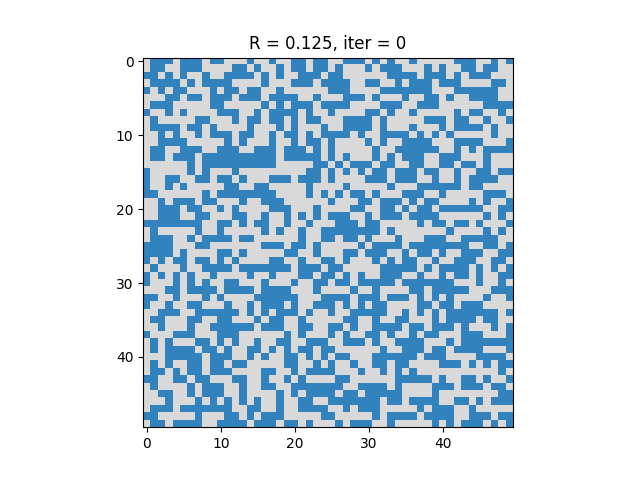

 22%|██▏       | 2/9 [00:14<00:50,  7.25s/it]

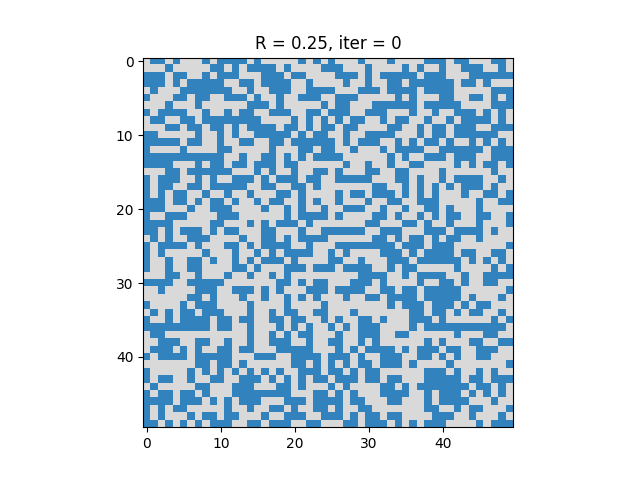

 33%|███▎      | 3/9 [00:21<00:42,  7.05s/it]

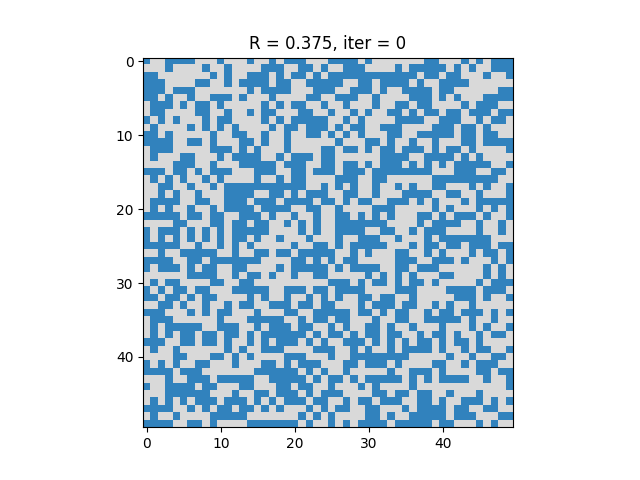

 44%|████▍     | 4/9 [00:27<00:34,  6.85s/it]

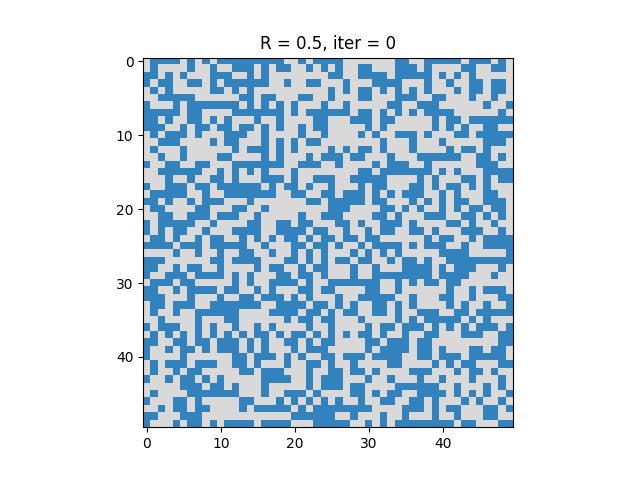

 56%|█████▌    | 5/9 [00:34<00:27,  6.87s/it]

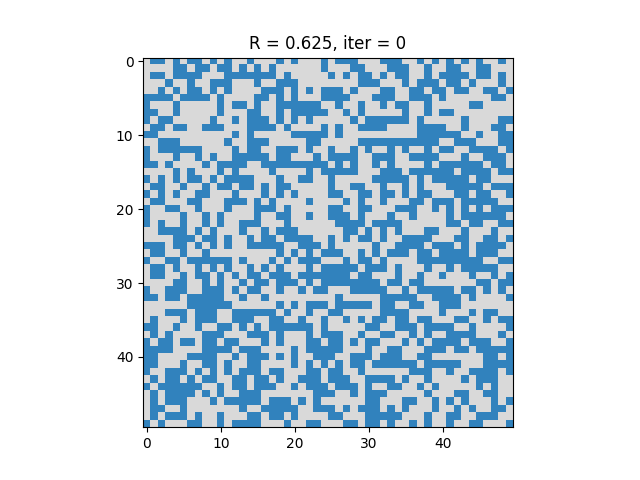

 67%|██████▋   | 6/9 [00:41<00:20,  6.86s/it]

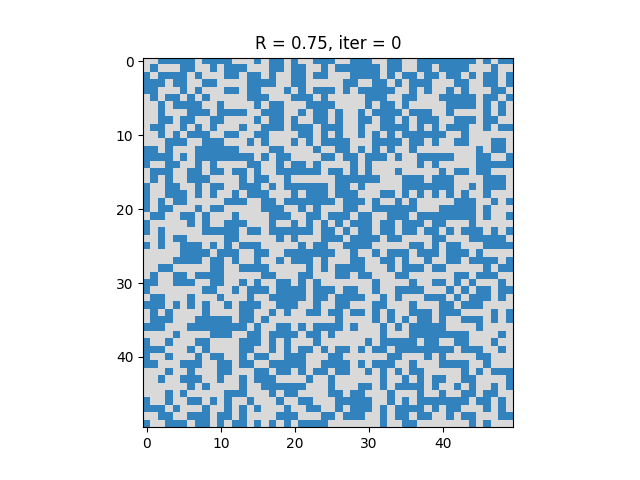

 78%|███████▊  | 7/9 [00:48<00:13,  6.87s/it]

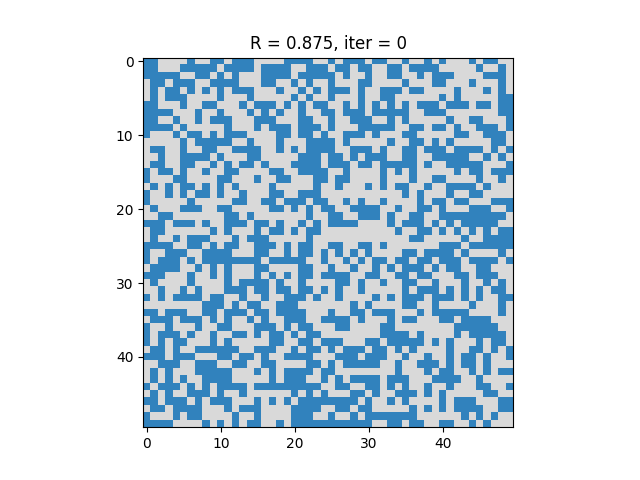

 89%|████████▉ | 8/9 [00:59<00:08,  8.27s/it]

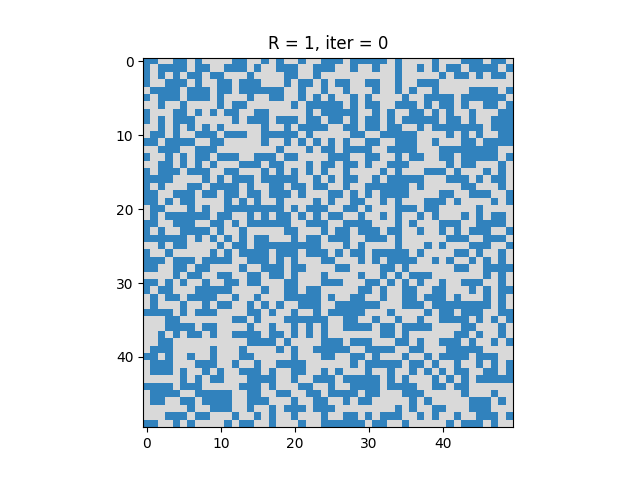

100%|██████████| 9/9 [01:11<00:00,  7.96s/it]


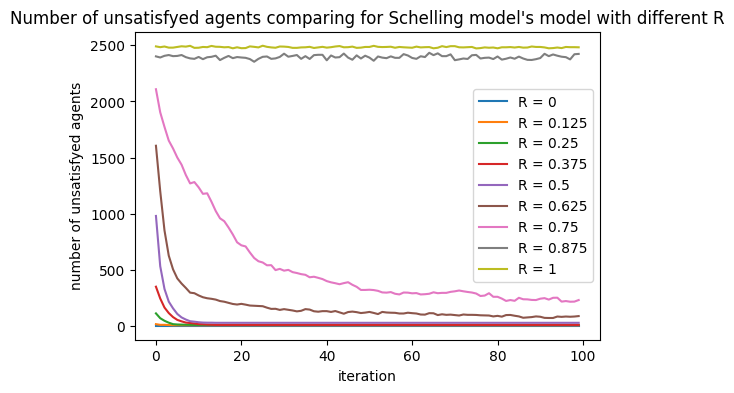

In [5]:
r_list = [0, 1/8, 2/8, 3/8, 4/8, 5/8, 6/8, 7/8, 1]


unsats = []
for r in tqdm(r_list):
    SM = SchellingModel(map_size=50, r=r, empty_coef=0)
    SM.make_iteration_process(100, gif_name=f'anim_{r}.gif')
    SM._display_gif()
    # SM._display_unsat_num()
    unsats.append(SM.number_of_unsat)

plt.figure(figsize=(6,4))
for r, unsat in zip(r_list, unsats):
    plt.plot(unsat, label = f'R = {r}')
plt.title("Number of unsatisfyed agents comparing for Schelling model's model with different R")
plt.xlabel('iteration')
plt.ylabel('number of unsatisfyed agents')
plt.legend()
plt.show()

  0%|          | 0/8 [00:00<?, ?it/s]

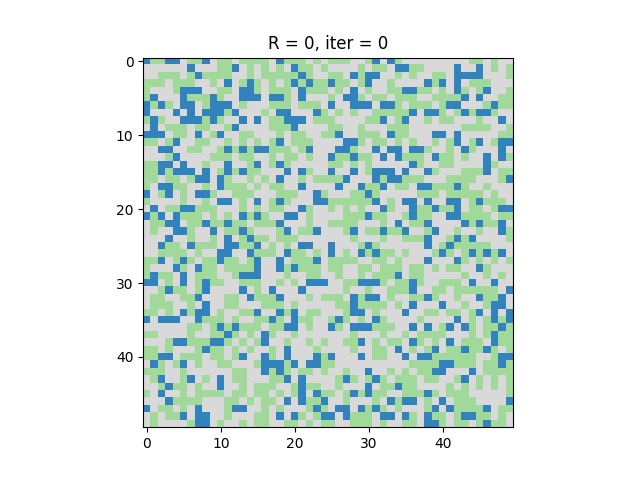

 12%|█▎        | 1/8 [00:07<00:54,  7.78s/it]

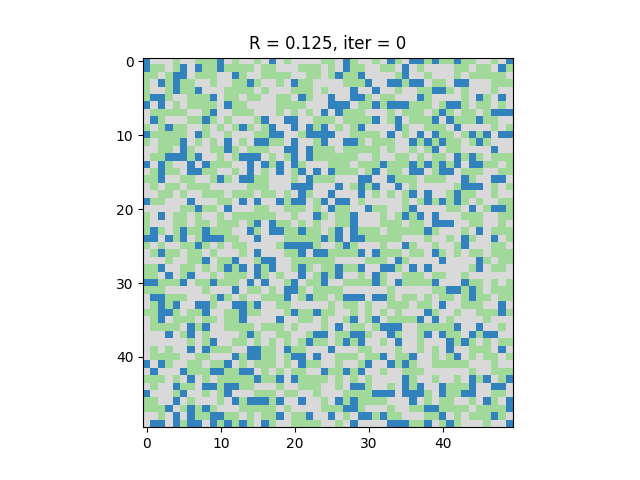

 25%|██▌       | 2/8 [00:15<00:45,  7.51s/it]

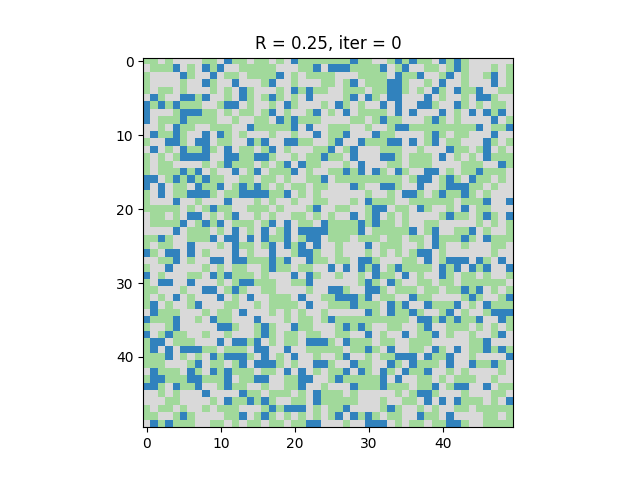

 38%|███▊      | 3/8 [00:22<00:36,  7.34s/it]

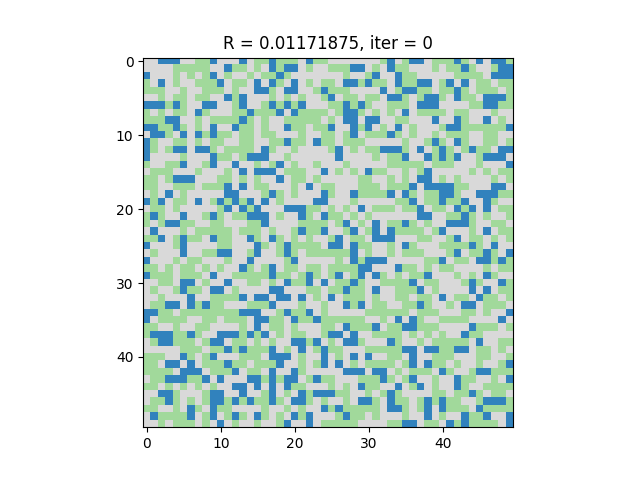

 50%|█████     | 4/8 [00:29<00:29,  7.25s/it]

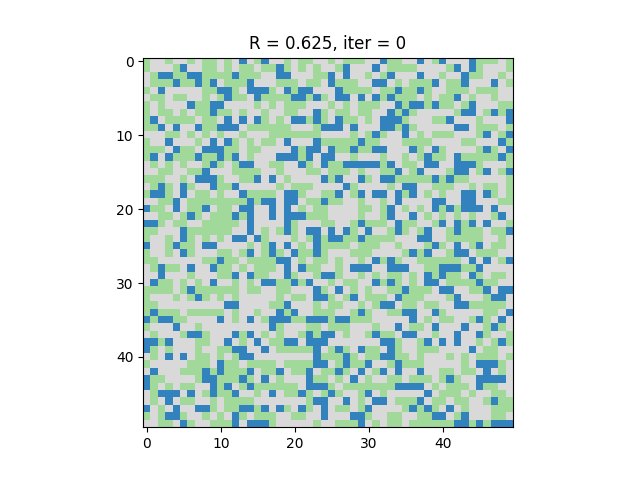

 62%|██████▎   | 5/8 [00:36<00:21,  7.31s/it]

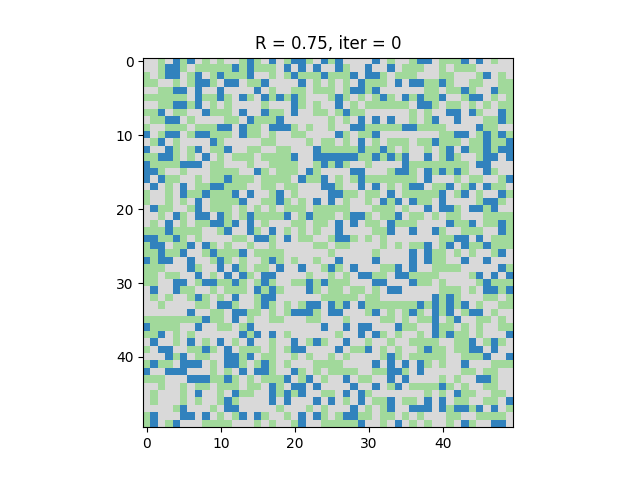

 75%|███████▌  | 6/8 [00:45<00:15,  7.80s/it]

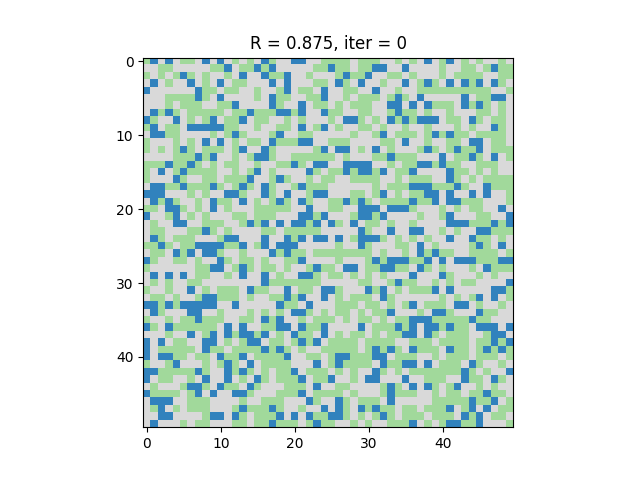

 88%|████████▊ | 7/8 [00:56<00:08,  8.88s/it]

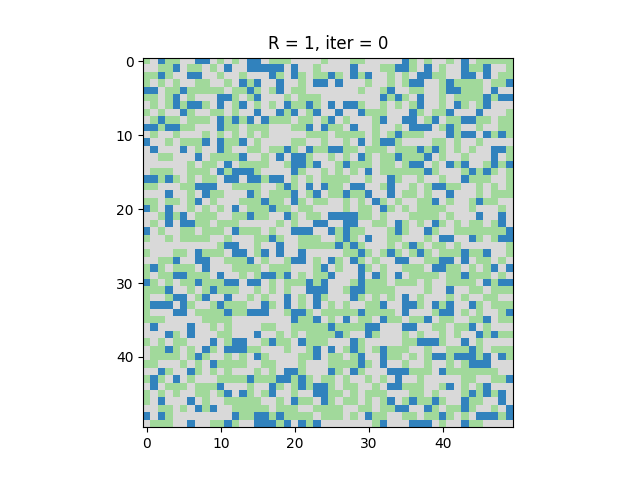

100%|██████████| 8/8 [01:07<00:00,  8.43s/it]


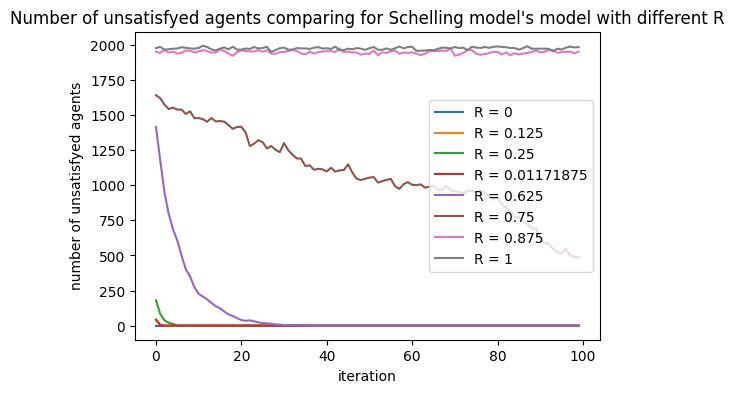

In [6]:
r_list = [0, 1/8, 2/8, 3/8/ 4/8, 5/8, 6/8, 7/8, 1]

unsats = []
for r in tqdm(r_list):
    SM = SchellingModel(map_size=50, r=r, empty_coef=0.2)
    SM.make_iteration_process(100, gif_name=f'anim_{r}_0.2.gif')
    SM._display_gif()
    # SM._display_unsat_num()
    unsats.append(SM.number_of_unsat)

plt.figure(figsize=(6,4))
for r, unsat in zip(r_list, unsats):
    plt.plot(unsat, label = f'R = {r}')
plt.title("Number of unsatisfyed agents comparing for Schelling model's model with different R")
plt.xlabel('iteration')
plt.ylabel('number of unsatisfyed agents')
plt.legend()
plt.show()

In [ ]:
# end